In [ ]:
import os
import cv2
import tensorflow as tf
import numpy as np
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt


In [ ]:
from google.colab import drive

drive.mount('/content/drive')



Mounted at /content/drive


## Frame Extraction from Videos

### `extract_frames_from_videos` Function
The **`extract_frames_from_videos`** function is designed to process videos located in the **`input_folder`**, which is organized into two categories: **`Violence`** and **`NonViolence`**. It extracts frames from these videos based on a specified **`frame_rate`** and saves the extracted frames in a designated **`output_folder`**. Here’s a breakdown of its functionality:

1. **Folder Structure**:
   - The function first checks for the existence of subfolders within the **`output_folder`** corresponding to the **`Violence`** and **`NonViolence`** categories. If these subfolders do not exist, they are created to organize the extracted frames appropriately.

2. **Frame Extraction**:
   - The function reads each video frame-by-frame, extracting frames at intervals defined by the **`frame_rate`** parameter. For example, if the **`frame_rate`** is set to 5, the function will save every 5th frame of the video.
   - Each extracted frame is saved with a filename that combines the original video filename and the frame number, ensuring that each file can be traced back to its source video.

3. **Resource Management**:
   - After processing all frames, the function releases the video resources to free up memory. This is crucial in preventing memory leaks and ensuring that the program runs efficiently.

This function is essential for preparing the dataset by converting video data into individual frames, which can then be used for training the violence detection model.


In [ ]:

def extract_frames_from_videos(input_folder, output_folder, frame_rate=30):
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    for category in ['Violence', 'NonViolence']:
        category_folder = os.path.join(input_folder, category)
        output_category_folder = os.path.join(output_folder, category)
        if not os.path.exists(output_category_folder):
            os.makedirs(output_category_folder)

        for filename in os.listdir(category_folder):
            video_path = os.path.join(category_folder, filename)
            video = cv2.VideoCapture(video_path)
            count = 0
            success = True

            while success:
                success, frame = video.read()
                if success and count % frame_rate == 0:
                    frame_file = os.path.join(output_category_folder, f"{filename}_frame_{count}.jpg")
                    cv2.imwrite(frame_file, frame)
                count += 1

            video.release()

input_folder = '/content/drive/My Drive/Real Life Violence Dataset'
output_folder = '/content/drive/My Drive/extracted_frames'
extract_frames_from_videos(input_folder, output_folder)


## Dataset Path Definition and Contents Listing

### 1. Defines the Dataset Path
The code sets the variable `dataset_path` to the Google Drive directory where your **"Real Life Violence Dataset"** is stored. This path is essential for accessing and loading the dataset during the training and evaluation processes.

### 2. Lists Folder Contents
The code utilizes `os.listdir(dataset_path)` to print all files and subfolders located within the specified dataset path. This functionality serves two purposes:
- **Verifying Accessibility**: It confirms that the dataset is correctly linked and accessible from the environment.
- **Checking Contents**: It allows you to review the contents of the dataset, ensuring that all necessary files and subfolders are present before proceeding with data processing or model training.


In [ ]:
dataset_path = '/content/drive/My Drive/Real Life Violence Dataset'

print(os.listdir(dataset_path))


['Violence', 'NonViolence']


## Violence Detection Model Explanation

The `create_violence_detection_model` function defines a Convolutional Neural Network (CNN) specifically designed for detecting violence in video frames. Below is a detailed breakdown of its structure:

### 1. Convolutional Layers
The model begins with three convolutional layers, each followed by a MaxPooling layer to help reduce the spatial dimensions of the data:

- **First Layer**:
  - 32 filters of size `3x3`.
  - Followed by a MaxPooling layer to down-sample the feature maps.

- **Second Layer**:
  - 64 filters of size `3x3`.
  - Followed by another MaxPooling layer for additional down-sampling.

- **Third Layer**:
  - 128 filters of size `3x3`.
  - Also followed by a MaxPooling layer.

These convolutional layers learn spatial features that are relevant for detecting violence in frames.

### 2. Flattening
After the convolutional layers, the multi-dimensional output is flattened into a 1D vector. This step prepares the data for the subsequent fully connected layers.

### 3. Dense Layers
- A fully connected layer with **512 neurons** and **ReLU** activation is included. This layer learns complex combinations of the features extracted by the convolutional layers.
- A **Dropout layer** with a rate of **0.5** is added to help prevent overfitting by randomly setting half of the neurons to zero during training.

### 4. Output Layer
- The output layer consists of **1 neuron** with a **sigmoid activation function**, which classifies the frames as either violent or non-violent.

### 5. Compilation
The model is compiled using:
- **Adam optimizer** for efficient optimization.
- **Binary cross-entropy loss** function, which is suitable for binary classification tasks.
- **Accuracy** as the evaluation metric, allowing for performance assessment during training.

### Input Shape
This model is designed to process images with an input shape of **224x224x3** (width, height, channels).


In [ ]:
def create_violence_detection_model(input_shape=(224, 224, 3)):
    model = Sequential()

    model.add(Conv2D(32, (3, 3), activation='relu', input_shape=input_shape))
    model.add(MaxPooling2D(pool_size=(2, 2)))

    model.add(Conv2D(64, (3, 3), activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))

    model.add(Conv2D(128, (3, 3), activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))

    model.add(Flatten())

    model.add(Dense(512, activation='relu'))
    model.add(Dropout(0.5))

    model.add(Dense(1, activation='sigmoid'))

    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

    return model


## Data Generator for Training and Validation

This project utilizes the `ImageDataGenerator` class from Keras to preprocess images for both training and validation purposes. The `train_datagen` object is configured to rescale the pixel values of the images to a range between 0 and 1 by dividing each pixel value by 255. Additionally, it splits the dataset into training and validation sets with a `validation_split` of 0.2, indicating that 80% of the data will be used for training, while 20% will be reserved for validation.

### Generators Overview

Two separate data generators are created to handle these respective data splits:

1. **train_generator**:
   - This generator loads images from the specified `output_folder`.
   - It resizes the images to `224x224` pixels, which is the target input size for the model.
   - The `batch_size` is set to 32, meaning each batch will contain 32 images.
   - The `class_mode` is set to `'binary'`, which indicates that the classification task is binary (0 or 1).
   - This generator specifically uses the training subset of data.

2. **validation_generator**:
   - Similar to `train_generator`, this generator also loads images from the `output_folder`.
   - It resizes images to `224x224` pixels.
   - The `batch_size` is again set to 32.
   - It uses the validation subset of data, which allows the model to be evaluated on unseen data during training.

### Functionality

Together, these generators provide batches of preprocessed images and their corresponding labels, supporting the model's training and evaluation processes. By using these generators, the model can learn from a diverse set of training images while being validated against a separate set of images, helping to improve generalization and performance.


In [ ]:
train_datagen = ImageDataGenerator(rescale=1./255, validation_split=0.2)

train_generator = train_datagen.flow_from_directory(
    output_folder,
    target_size=(224, 224),
    batch_size=32,
    class_mode='binary',
    subset='training'
)

validation_generator = train_datagen.flow_from_directory(
    output_folder,
    target_size=(224, 224),
    batch_size=32,
    class_mode='binary',
    subset='validation'
)


Found 8361 images belonging to 2 classes.
Found 2090 images belonging to 2 classes.


### Model Building and Training

The code begins by building the violence detection model using the `create_violence_detection_model()` function.

- **Model Training**: The `model.fit()` method trains the model using the `train_generator`, which supplies the training data. The model is trained for 10 epochs, meaning it will pass through the entire training dataset 10 times. The `validation_data` parameter is set to `validation_generator`, allowing the model to evaluate its performance on the validation set after each epoch.

- **Saving the Trained Model**: After training, the model is saved to Google Drive using the `model.save()` method. The saved model file is named `violence_detection_model.keras`, allowing for future use in predictions or further training.

This process creates a trained model capable of detecting violence in video frames, stored in the specified directory for later use.


In [ ]:
model = create_violence_detection_model()

model.fit(
    train_generator,
    epochs=10,
    validation_data=validation_generator
)

# model.save('violence_detection_model.h5')

model.save('/content/drive/My Drive/Real Life Violence Dataset/violence_detection_model.keras')




Epoch 1/10
262/262 ━━━━━━━━━━━━━━━━━━━━ 74s 261ms/step - accuracy: 0.6642 - loss: 0.6830 - val_accuracy: 0.6359 - val_loss: 0.7127
Epoch 2/10
262/262 ━━━━━━━━━━━━━━━━━━━━ 82s 305ms/step - accuracy: 0.8875 - loss: 0.2703 - val_accuracy: 0.7789 - val_loss: 0.4884
Epoch 3/10
262/262 ━━━━━━━━━━━━━━━━━━━━ 76s 284ms/step - accuracy: 0.9490 - loss: 0.1376 - val_accuracy: 0.7311 - val_loss: 0.6372
Epoch 4/10
262/262 ━━━━━━━━━━━━━━━━━━━━ 75s 258ms/step - accuracy: 0.9650 - loss: 0.0850 - val_accuracy: 0.7148 - val_loss: 0.9051
Epoch 5/10
262/262 ━━━━━━━━━━━━━━━━━━━━ 76s 284ms/step - accuracy: 0.9875 - loss: 0.0375 - val_accuracy: 0.7254 - val_loss: 1.2954
Epoch 6/10
262/262 ━━━━━━━━━━━━━━━━━━━━ 69s 258ms/step - accuracy: 0.9853 - loss: 0.0428 - val_accuracy: 0.7646 - val_loss: 1.1238
Epoch 7/10
262/262 ━━━━━━━━━━━━━━━━━━━━ 80s 252ms/step - accuracy: 0.9912 - loss: 0.0230 - val_accuracy: 0.7502 - val_loss: 1.4415
Epoch 8/10
262/262 ━━━━━━━━━━━━━━━━━━━━ 66s 248ms/step - accuracy: 0.9918 - loss: 0

### Video Analysis for Violence Detection

The code uses OpenCV and a pre-trained Keras model to analyze a video and extract frames that contain violence.

- **Model Loading**: The trained violence detection model is loaded using `load_model()`, allowing the program to make predictions on video frames.

- **Video Path**: The path to the video being analyzed is specified. Adjust this path to point to the correct video file.

- **Output Directory**: An output directory named `violent_frames` is created to store any detected violent frames. If the directory does not already exist, it is created using `os.makedirs()`.

- **Frame Preprocessing**: The `preprocess_frame()` function resizes each frame to 224x224 pixels, converts it to an array, expands its dimensions to match the model's input shape, and rescales pixel values to the range [0, 1].

- **Video Analysis**: The `analyze_video()` function reads the video frame by frame using OpenCV. For each frame:
  - The frame is preprocessed for prediction.
  - A prediction is made using the loaded model. If the prediction probability exceeds 0.6, the frame is classified as containing violence.
  - Violent frames are saved in the `violent_frames` directory and displayed using Matplotlib, showing the frame along with its prediction probability.
  - If a violent frame is detected, the analysis skips the next 5 seconds of the video to avoid redundant predictions.

- **Completion Message**: At the end of the analysis, the program prints a message indicating whether any violent frames were detected. If none are found, it classifies the video as non-violent.

This process enables efficient analysis of videos for violence detection, allowing for immediate visual feedback on the detected frames.


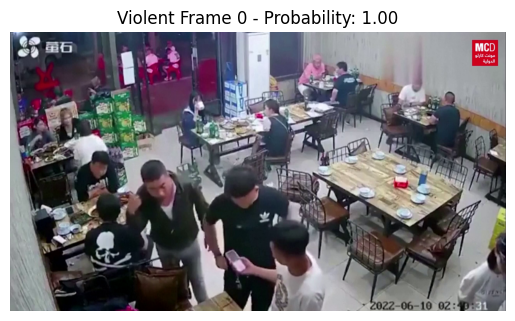

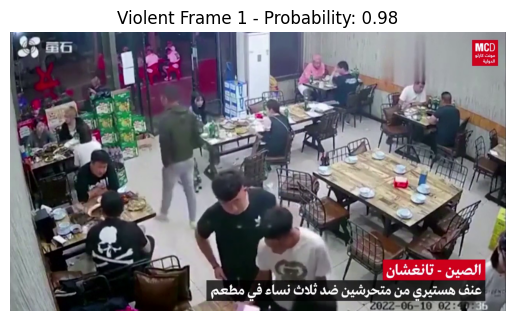

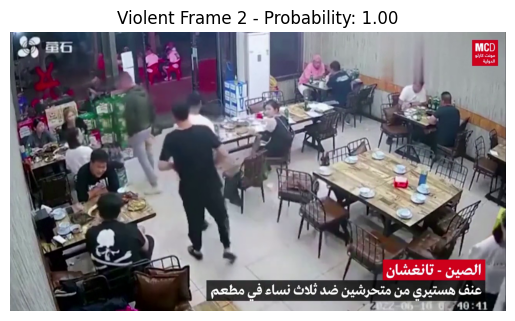

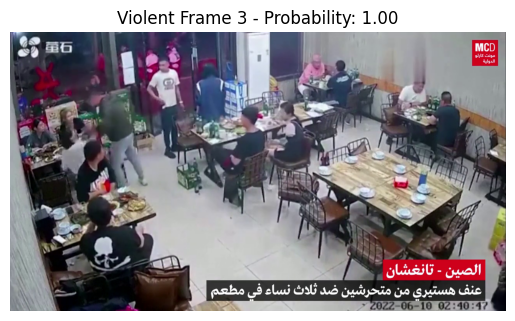

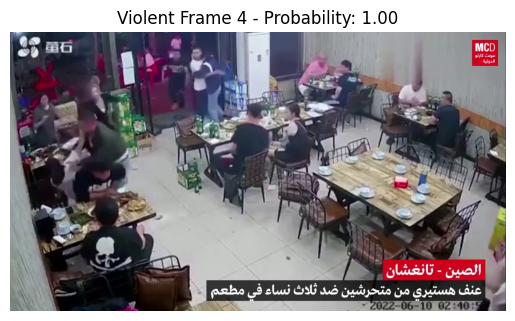

...

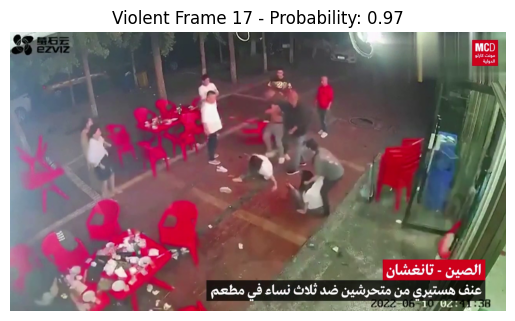

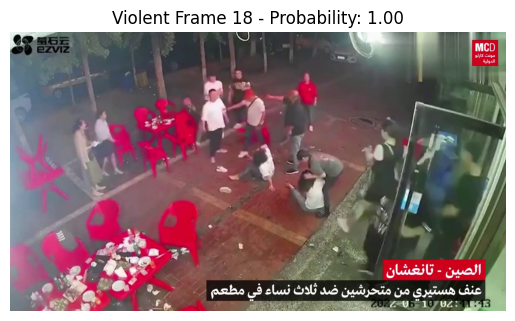

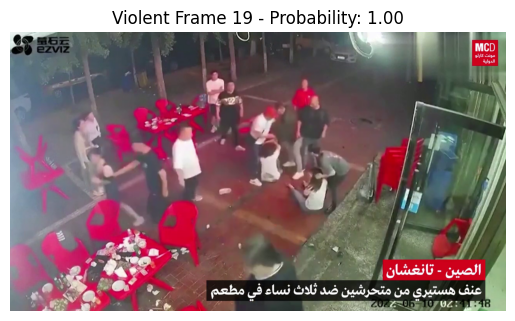

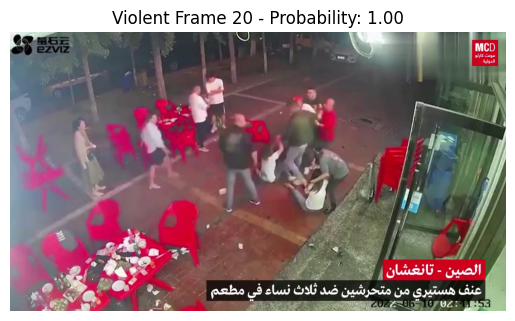

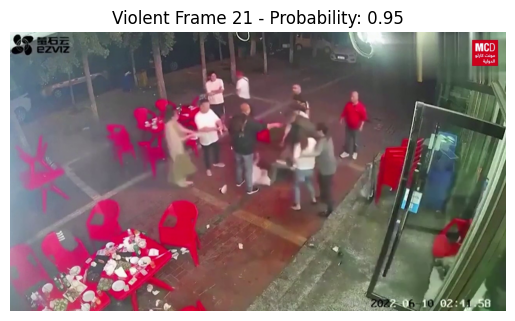

Analysis complete. Violent frames detected: 22.


In [ ]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import img_to_array
import tensorflow as tf

# Disable TensorFlow logging
tf.get_logger().setLevel('ERROR')

# Load the trained model in SavedModel format
model = load_model('/content/drive/My Drive/Real Life Violence Dataset/violence_detection_model.keras')

# Path to the video that will be tested
video_path = '/content/drive/My Drive/video_test/test2.mp4'  # Adjusted path to include the video folder

# Directory to save violent frames
output_violent_frames_dir = 'violent_frames'
if not os.path.exists(output_violent_frames_dir):
    os.makedirs(output_violent_frames_dir)

# Function to preprocess the frame for the model
def preprocess_frame(frame):
    frame = cv2.resize(frame, (224, 224))  # Resize the frame to (224, 224)
    frame = img_to_array(frame)  # Convert the frame to an array
    frame = np.expand_dims(frame, axis=0)  # Add an additional dimension
    frame = frame / 255.0  # Rescale values to [0,1]
    return frame

# Function to analyze the video and extract violent frames
def analyze_video(video_path):
    cap = cv2.VideoCapture(video_path)
    violent_frame_count = 0
    fps = int(cap.get(cv2.CAP_PROP_FPS))  # Get frames per second

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Prepare the frame for prediction
        processed_frame = preprocess_frame(frame)

        # Make predictions using the model
        prediction = model.predict(processed_frame, verbose=0)[0][0]

        if prediction > 0.6:  # If the value > 0.6, classify as violence
            violent_frame_filename = os.path.join(output_violent_frames_dir, f"violent_frame{violent_frame_count}.jpg")
            cv2.imwrite(violent_frame_filename, frame)

            # Display the violent frame
            plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
            plt.title(f"Violent Frame {violent_frame_count} - Probability: {prediction:.2f}")
            plt.axis('off')
            plt.show()

            violent_frame_count += 1

            # Skip 5 seconds of video
            skip_frames = fps * 5  # Number of frames to skip in 5 seconds
            cap.set(cv2.CAP_PROP_POS_FRAMES, cap.get(cv2.CAP_PROP_POS_FRAMES) + skip_frames)

    cap.release()

    # If no violent frames are detected, print the message
    if violent_frame_count == 0:
        print("No violent frames detected. The video is classified as non-violent.")
    else:
        print(f"Analysis complete. Violent frames detected: {violent_frame_count}.")

# Test the video
analyze_video(video_path)


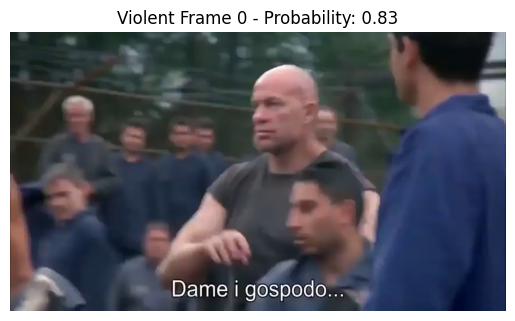

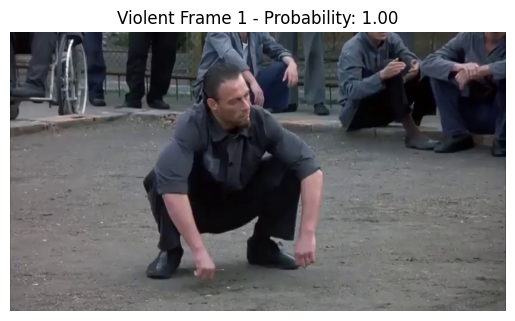

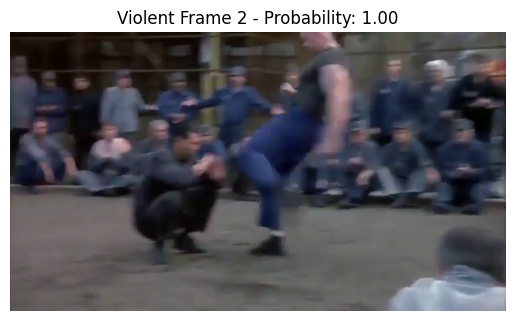

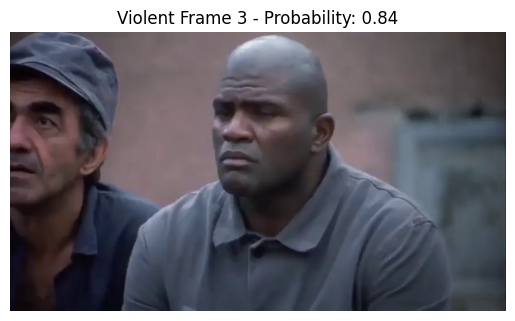

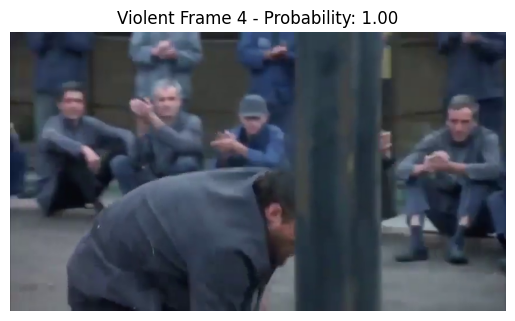

...

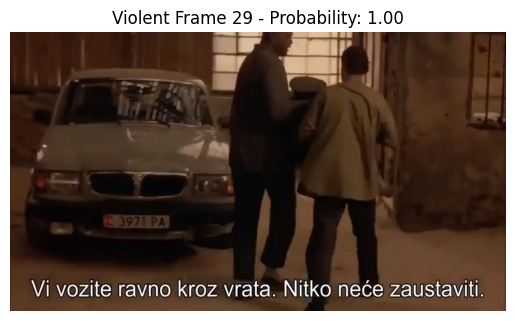

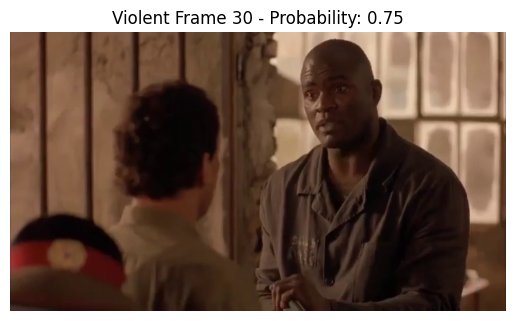

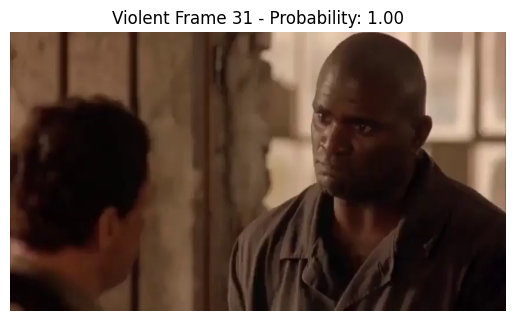

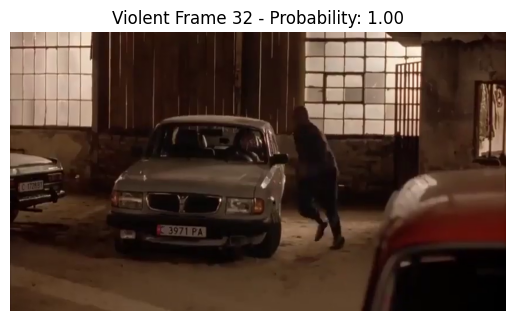

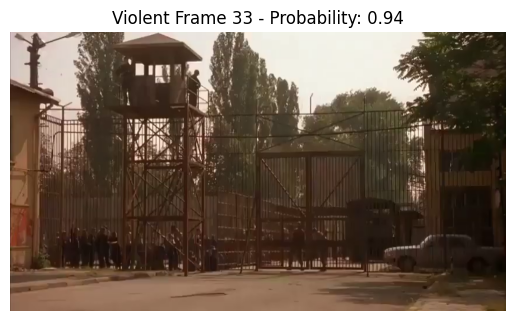

Analysis complete. Violent frames detected: 34.


In [ ]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import img_to_array
import tensorflow as tf

# Disable TensorFlow logging
tf.get_logger().setLevel('ERROR')

# Load the trained model in SavedModel format
model = load_model('/content/drive/My Drive/Real Life Violence Dataset/violence_detection_model.keras')

# Path to the video that will be tested
video_path = '/content/drive/My Drive/video_test/test3.mp4'  # Adjusted path to include the video folder

# Directory to save violent frames
output_violent_frames_dir = 'violent_frames'
if not os.path.exists(output_violent_frames_dir):
    os.makedirs(output_violent_frames_dir)

# Function to preprocess the frame for the model
def preprocess_frame(frame):
    frame = cv2.resize(frame, (224, 224))  # Resize the frame to (224, 224)
    frame = img_to_array(frame)  # Convert the frame to an array
    frame = np.expand_dims(frame, axis=0)  # Add an additional dimension
    frame = frame / 255.0  # Rescale values to [0,1]
    return frame

# Function to analyze the video and extract violent frames
def analyze_video(video_path):
    cap = cv2.VideoCapture(video_path)
    violent_frame_count = 0
    fps = int(cap.get(cv2.CAP_PROP_FPS))  # Get frames per second

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Prepare the frame for prediction
        processed_frame = preprocess_frame(frame)

        # Make predictions using the model
        prediction = model.predict(processed_frame, verbose=0)[0][0]

        if prediction > 0.7:  # If the value > 0.7, classify as violence
            violent_frame_filename = os.path.join(output_violent_frames_dir, f"violent_frame{violent_frame_count}.jpg")
            cv2.imwrite(violent_frame_filename, frame)

            # Display the violent frame
            plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
            plt.title(f"Violent Frame {violent_frame_count} - Probability: {prediction:.2f}")
            plt.axis('off')
            plt.show()

            violent_frame_count += 1

            # Skip 10 seconds of video
            skip_frames = fps * 10  # Number of frames to skip in 10 seconds
            cap.set(cv2.CAP_PROP_POS_FRAMES, cap.get(cv2.CAP_PROP_POS_FRAMES) + skip_frames)

    cap.release()

    # If no violent frames are detected, print the message
    if violent_frame_count == 0:
        print("No violent frames detected. The video is classified as non-violent.")
    else:
        print(f"Analysis complete. Violent frames detected: {violent_frame_count}.")

# Test the video
analyze_video(video_path)


In [1]:
from google.colab import drive

drive.mount('/content/drive')



Mounted at /content/drive


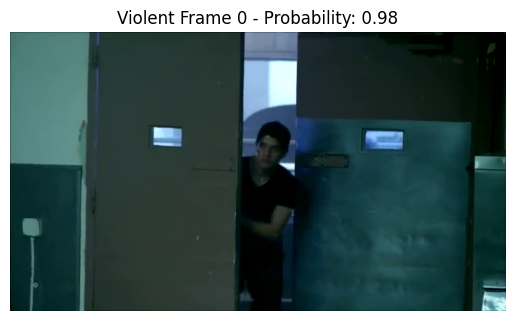

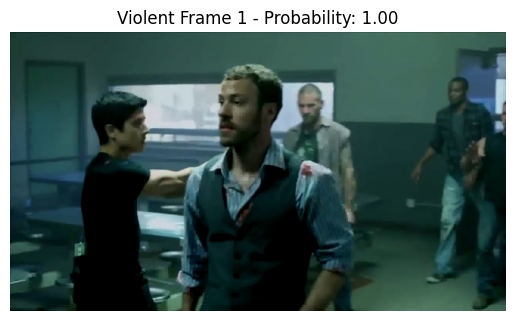

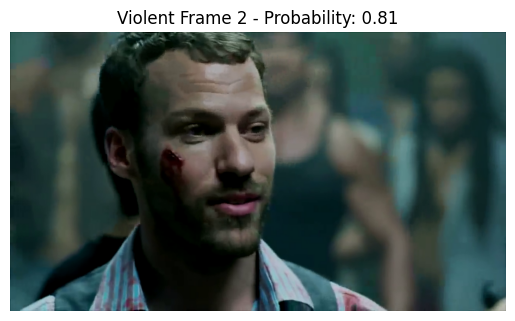

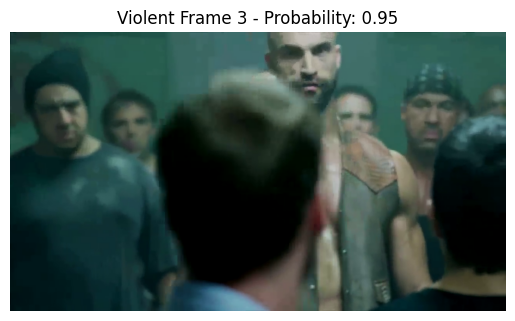

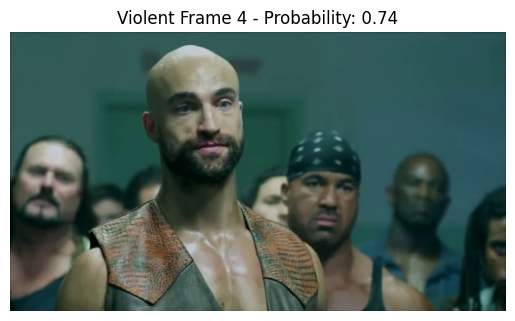

...

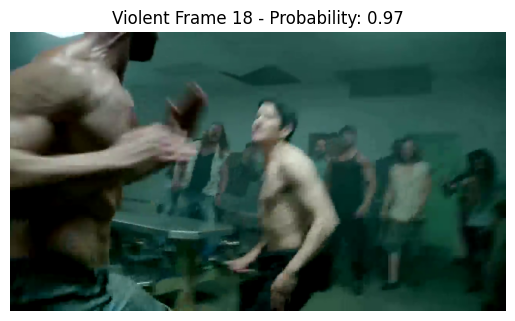

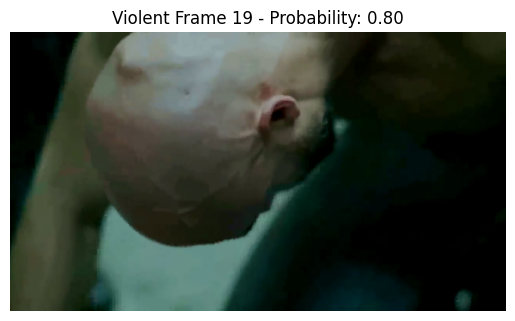

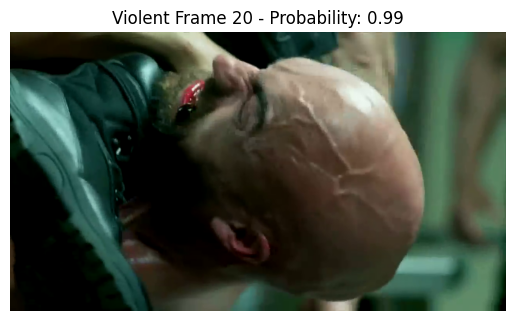

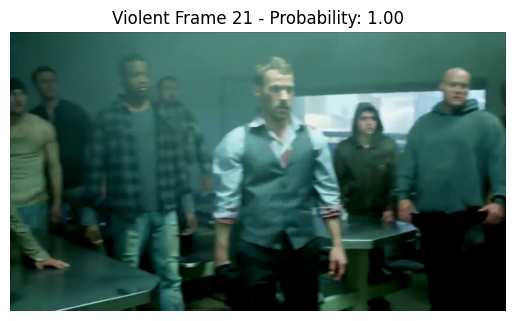

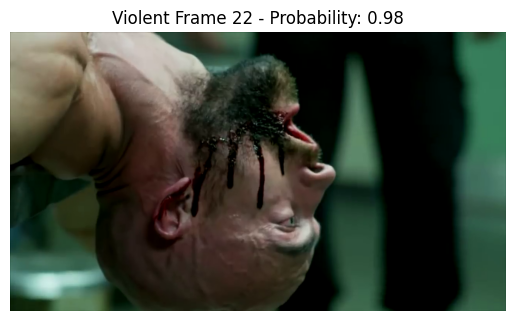

Analysis complete. Violent frames detected: 23.


In [ ]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import img_to_array
import tensorflow as tf

# Disable TensorFlow logging
tf.get_logger().setLevel('ERROR')

# Load the trained model in SavedModel format
model = load_model('/content/drive/My Drive/Real Life Violence Dataset/violence_detection_model.keras')

# Path to the video that will be tested
video_path = '/content/drive/My Drive/video_test/test4.mp4'  # Adjusted path to include the video folder

# Directory to save violent frames
output_violent_frames_dir = 'violent_frames'
if not os.path.exists(output_violent_frames_dir):
    os.makedirs(output_violent_frames_dir)

# Function to preprocess the frame for the model
def preprocess_frame(frame):
    frame = cv2.resize(frame, (224, 224))  # Resize the frame to (224, 224)
    frame = img_to_array(frame)  # Convert the frame to an array
    frame = np.expand_dims(frame, axis=0)  # Add an additional dimension
    frame = frame / 255.0  # Rescale values to [0,1]
    return frame

# Function to analyze the video and extract violent frames
def analyze_video(video_path):
    cap = cv2.VideoCapture(video_path)
    violent_frame_count = 0
    fps = int(cap.get(cv2.CAP_PROP_FPS))  # Get frames per second

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Prepare the frame for prediction
        processed_frame = preprocess_frame(frame)

        # Make predictions using the model
        prediction = model.predict(processed_frame, verbose=0)[0][0]

        if prediction > 0.7:  # If the value > 0.7, classify as violence
            violent_frame_filename = os.path.join(output_violent_frames_dir, f"violent_frame{violent_frame_count}.jpg")
            cv2.imwrite(violent_frame_filename, frame)

            # Display the violent frame
            plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
            plt.title(f"Violent Frame {violent_frame_count} - Probability: {prediction:.2f}")
            plt.axis('off')
            plt.show()

            violent_frame_count += 1

            # Skip 10 seconds of video
            skip_frames = fps * 10  # Number of frames to skip in 10 seconds
            cap.set(cv2.CAP_PROP_POS_FRAMES, cap.get(cv2.CAP_PROP_POS_FRAMES) + skip_frames)

    cap.release()

    # If no violent frames are detected, print the message
    if violent_frame_count == 0:
        print("No violent frames detected. The video is classified as non-violent.")
    else:
        print(f"Analysis complete. Violent frames detected: {violent_frame_count}.")

# Test the video
analyze_video(video_path)


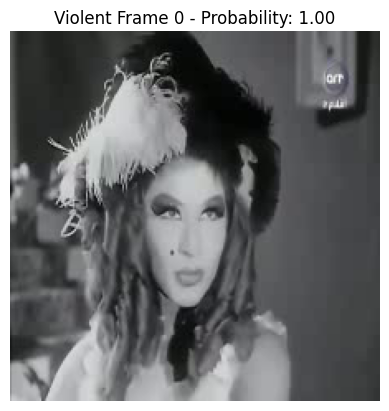

Analysis complete. Violent frames detected: 1.


In [ ]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import img_to_array
import tensorflow as tf

# Disable TensorFlow logging
tf.get_logger().setLevel('ERROR')

# Load the trained model in SavedModel format
model = load_model('/content/drive/My Drive/Real Life Violence Dataset/violence_detection_model.keras')

# Path to the video that will be tested
video_path = '/content/drive/My Drive/video_test/test5.mp4'  # Adjusted path to include the video folder

# Directory to save violent frames
output_violent_frames_dir = 'violent_frames'
if not os.path.exists(output_violent_frames_dir):
    os.makedirs(output_violent_frames_dir)

# Function to preprocess the frame for the model
def preprocess_frame(frame):
    frame = cv2.resize(frame, (224, 224))  # Resize the frame to (224, 224)
    frame = img_to_array(frame)  # Convert the frame to an array
    frame = np.expand_dims(frame, axis=0)  # Add an additional dimension
    frame = frame / 255.0  # Rescale values to [0,1]
    return frame

# Function to analyze the video and extract violent frames
def analyze_video(video_path):
    cap = cv2.VideoCapture(video_path)
    violent_frame_count = 0
    fps = int(cap.get(cv2.CAP_PROP_FPS))  # Get frames per second

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Prepare the frame for prediction
        processed_frame = preprocess_frame(frame)

        # Make predictions using the model
        prediction = model.predict(processed_frame, verbose=0)[0][0]

        if prediction > 0.7:  # If the value > 0.7, classify as violence
            violent_frame_filename = os.path.join(output_violent_frames_dir, f"violent_frame{violent_frame_count}.jpg")
            cv2.imwrite(violent_frame_filename, frame)

            # Display the violent frame
            plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
            plt.title(f"Violent Frame {violent_frame_count} - Probability: {prediction:.2f}")
            plt.axis('off')
            plt.show()

            violent_frame_count += 1

            # Skip 10 seconds of video
            skip_frames = fps * 10  # Number of frames to skip in 10 seconds
            cap.set(cv2.CAP_PROP_POS_FRAMES, cap.get(cv2.CAP_PROP_POS_FRAMES) + skip_frames)

    cap.release()

    # If no violent frames are detected, print the message
    if violent_frame_count == 0:
        print("No violent frames detected. The video is classified as non-violent.")
    else:
        print(f"Analysis complete. Violent frames detected: {violent_frame_count}.")

# Test the video
analyze_video(video_path)


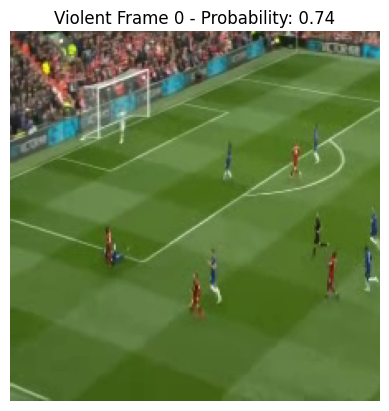

Analysis complete. Violent frames detected: 1.


In [ ]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import img_to_array
import tensorflow as tf

# Disable TensorFlow logging
tf.get_logger().setLevel('ERROR')

# Load the trained model in SavedModel format
model = load_model('/content/drive/My Drive/Real Life Violence Dataset/violence_detection_model.keras')

# Path to the video that will be tested
video_path = '/content/drive/My Drive/video_test/test6.mp4'  # Adjusted path to include the video folder

# Directory to save violent frames
output_violent_frames_dir = 'violent_frames'
if not os.path.exists(output_violent_frames_dir):
    os.makedirs(output_violent_frames_dir)

# Function to preprocess the frame for the model
def preprocess_frame(frame):
    frame = cv2.resize(frame, (224, 224))  # Resize the frame to (224, 224)
    frame = img_to_array(frame)  # Convert the frame to an array
    frame = np.expand_dims(frame, axis=0)  # Add an additional dimension
    frame = frame / 255.0  # Rescale values to [0,1]
    return frame

# Function to analyze the video and extract violent frames
def analyze_video(video_path):
    cap = cv2.VideoCapture(video_path)
    violent_frame_count = 0
    fps = int(cap.get(cv2.CAP_PROP_FPS))  # Get frames per second

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Prepare the frame for prediction
        processed_frame = preprocess_frame(frame)

        # Make predictions using the model
        prediction = model.predict(processed_frame, verbose=0)[0][0]

        if prediction > 0.7:  # If the value > 0.7, classify as violence
            violent_frame_filename = os.path.join(output_violent_frames_dir, f"violent_frame{violent_frame_count}.jpg")
            cv2.imwrite(violent_frame_filename, frame)

            # Display the violent frame
            plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
            plt.title(f"Violent Frame {violent_frame_count} - Probability: {prediction:.2f}")
            plt.axis('off')
            plt.show()

            violent_frame_count += 1

            # Skip 10 seconds of video
            skip_frames = fps * 10  # Number of frames to skip in 10 seconds
            cap.set(cv2.CAP_PROP_POS_FRAMES, cap.get(cv2.CAP_PROP_POS_FRAMES) + skip_frames)

    cap.release()

    # If no violent frames are detected, print the message
    if violent_frame_count == 0:
        print("No violent frames detected. The video is classified as non-violent.")
    else:
        print(f"Analysis complete. Violent frames detected: {violent_frame_count}.")

# Test the video
analyze_video(video_path)


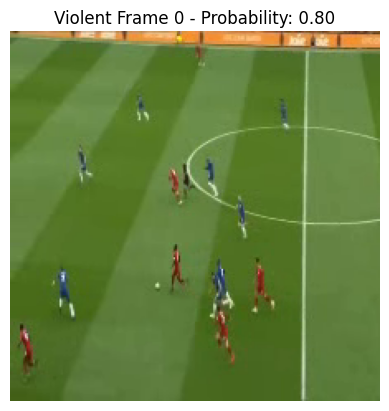

Analysis complete. Violent frames detected: 1.


In [ ]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import img_to_array
import tensorflow as tf

# Disable TensorFlow logging
tf.get_logger().setLevel('ERROR')

# Load the trained model in SavedModel format
model = load_model('/content/drive/My Drive/Real Life Violence Dataset/violence_detection_model.keras')

# Path to the video that will be tested
video_path = '/content/drive/My Drive/video_test/test7.mp4'  # Adjusted path to include the video folder

# Directory to save violent frames
output_violent_frames_dir = 'violent_frames'
if not os.path.exists(output_violent_frames_dir):
    os.makedirs(output_violent_frames_dir)

# Function to preprocess the frame for the model
def preprocess_frame(frame):
    frame = cv2.resize(frame, (224, 224))  # Resize the frame to (224, 224)
    frame = img_to_array(frame)  # Convert the frame to an array
    frame = np.expand_dims(frame, axis=0)  # Add an additional dimension
    frame = frame / 255.0  # Rescale values to [0,1]
    return frame

# Function to analyze the video and extract violent frames
def analyze_video(video_path):
    cap = cv2.VideoCapture(video_path)
    violent_frame_count = 0
    fps = int(cap.get(cv2.CAP_PROP_FPS))  # Get frames per second

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Prepare the frame for prediction
        processed_frame = preprocess_frame(frame)

        # Make predictions using the model
        prediction = model.predict(processed_frame, verbose=0)[0][0]

        if prediction > 0.7:  # If the value > 0.7, classify as violence
            violent_frame_filename = os.path.join(output_violent_frames_dir, f"violent_frame{violent_frame_count}.jpg")
            cv2.imwrite(violent_frame_filename, frame)

            # Display the violent frame
            plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
            plt.title(f"Violent Frame {violent_frame_count} - Probability: {prediction:.2f}")
            plt.axis('off')
            plt.show()

            violent_frame_count += 1

            # Skip 10 seconds of video
            skip_frames = fps * 10  # Number of frames to skip in 10 seconds
            cap.set(cv2.CAP_PROP_POS_FRAMES, cap.get(cv2.CAP_PROP_POS_FRAMES) + skip_frames)

    cap.release()

    # If no violent frames are detected, print the message
    if violent_frame_count == 0:
        print("No violent frames detected. The video is classified as non-violent.")
    else:
        print(f"Analysis complete. Violent frames detected: {violent_frame_count}.")

# Test the video
analyze_video(video_path)


In [ ]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import img_to_array
import tensorflow as tf

# Disable TensorFlow logging
tf.get_logger().setLevel('ERROR')

# Load the trained model in SavedModel format
model = load_model('/content/drive/My Drive/Real Life Violence Dataset/violence_detection_model.keras')

# Path to the video that will be tested
video_path = '/content/drive/My Drive/video_test/test8.mp4'  # Adjusted path to include the video folder

# Directory to save violent frames
output_violent_frames_dir = 'violent_frames'
if not os.path.exists(output_violent_frames_dir):
    os.makedirs(output_violent_frames_dir)

# Function to preprocess the frame for the model
def preprocess_frame(frame):
    frame = cv2.resize(frame, (224, 224))  # Resize the frame to (224, 224)
    frame = img_to_array(frame)  # Convert the frame to an array
    frame = np.expand_dims(frame, axis=0)  # Add an additional dimension
    frame = frame / 255.0  # Rescale values to [0,1]
    return frame

# Function to analyze the video and extract violent frames
def analyze_video(video_path):
    cap = cv2.VideoCapture(video_path)
    violent_frame_count = 0
    fps = int(cap.get(cv2.CAP_PROP_FPS))  # Get frames per second

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Prepare the frame for prediction
        processed_frame = preprocess_frame(frame)

        # Make predictions using the model
        prediction = model.predict(processed_frame, verbose=0)[0][0]

        if prediction > 0.7:  # If the value > 0.7, classify as violence
            violent_frame_filename = os.path.join(output_violent_frames_dir, f"violent_frame{violent_frame_count}.jpg")
            cv2.imwrite(violent_frame_filename, frame)

            # Display the violent frame
            plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
            plt.title(f"Violent Frame {violent_frame_count} - Probability: {prediction:.2f}")
            plt.axis('off')
            plt.show()

            violent_frame_count += 1

            # Skip 10 seconds of video
            skip_frames = fps * 10  # Number of frames to skip in 10 seconds
            cap.set(cv2.CAP_PROP_POS_FRAMES, cap.get(cv2.CAP_PROP_POS_FRAMES) + skip_frames)

    cap.release()

    # If no violent frames are detected, print the message
    if violent_frame_count == 0:
        print("No violent frames detected. The video is classified as non-violent.")
    else:
        print(f"Analysis complete. Violent frames detected: {violent_frame_count}.")

# Test the video
analyze_video(video_path)


No violent frames detected. The video is classified as non-violent.


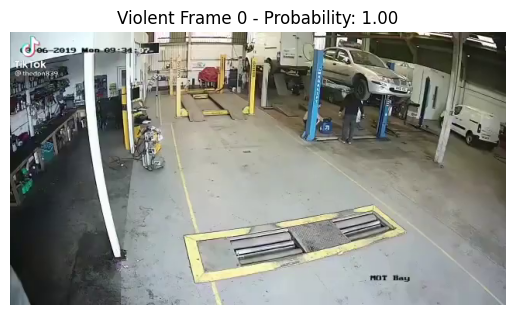

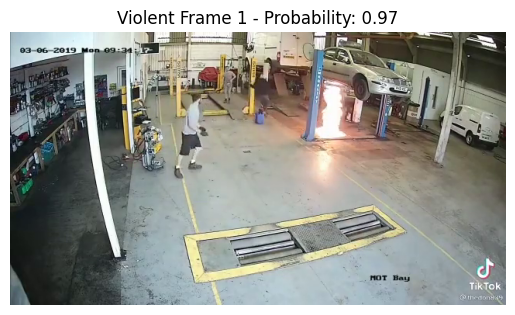

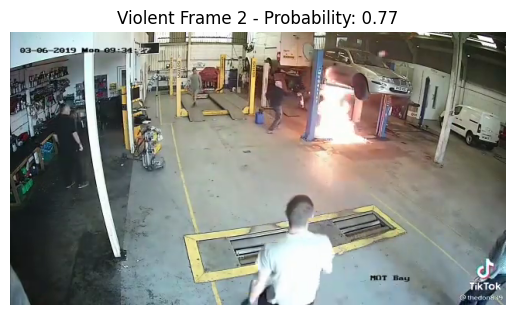

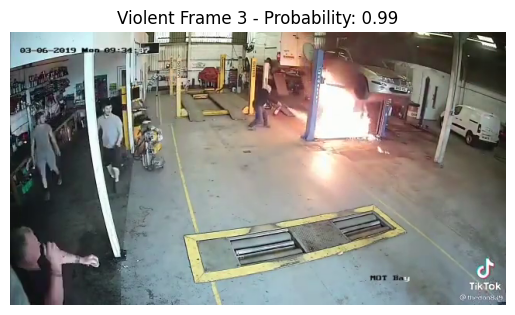

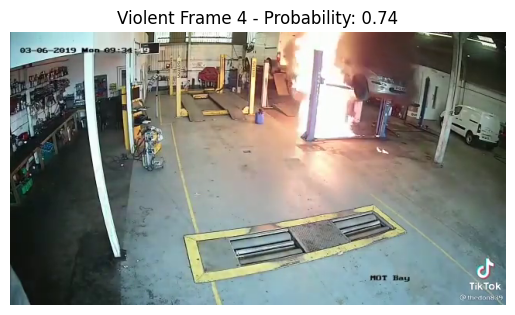

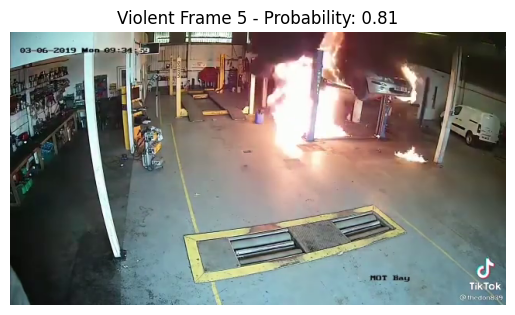

Analysis complete. Violent frames detected: 6.


In [ ]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import img_to_array
import tensorflow as tf

# Disable TensorFlow logging
tf.get_logger().setLevel('ERROR')

# Load the trained model in SavedModel format
model = load_model('/content/drive/My Drive/Real Life Violence Dataset/violence_detection_model.keras')

# Path to the video that will be tested
video_path = '/content/drive/My Drive/video_test/test9.mp4'  # Adjusted path to include the video folder

# Directory to save violent frames
output_violent_frames_dir = 'violent_frames'
if not os.path.exists(output_violent_frames_dir):
    os.makedirs(output_violent_frames_dir)

# Function to preprocess the frame for the model
def preprocess_frame(frame):
    frame = cv2.resize(frame, (224, 224))  # Resize the frame to (224, 224)
    frame = img_to_array(frame)  # Convert the frame to an array
    frame = np.expand_dims(frame, axis=0)  # Add an additional dimension
    frame = frame / 255.0  # Rescale values to [0,1]
    return frame

# Function to analyze the video and extract violent frames
def analyze_video(video_path):
    cap = cv2.VideoCapture(video_path)
    violent_frame_count = 0
    fps = int(cap.get(cv2.CAP_PROP_FPS))  # Get frames per second

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Prepare the frame for prediction
        processed_frame = preprocess_frame(frame)

        # Make predictions using the model
        prediction = model.predict(processed_frame, verbose=0)[0][0]

        if prediction > 0.7:  # If the value > 0.7, classify as violence
            violent_frame_filename = os.path.join(output_violent_frames_dir, f"violent_frame{violent_frame_count}.jpg")
            cv2.imwrite(violent_frame_filename, frame)

            # Display the violent frame
            plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
            plt.title(f"Violent Frame {violent_frame_count} - Probability: {prediction:.2f}")
            plt.axis('off')
            plt.show()

            violent_frame_count += 1

            # Skip 10 seconds of video
            skip_frames = fps * 10  # Number of frames to skip in 10 seconds
            cap.set(cv2.CAP_PROP_POS_FRAMES, cap.get(cv2.CAP_PROP_POS_FRAMES) + skip_frames)

    cap.release()

    # If no violent frames are detected, print the message
    if violent_frame_count == 0:
        print("No violent frames detected. The video is classified as non-violent.")
    else:
        print(f"Analysis complete. Violent frames detected: {violent_frame_count}.")

# Test the video
analyze_video(video_path)


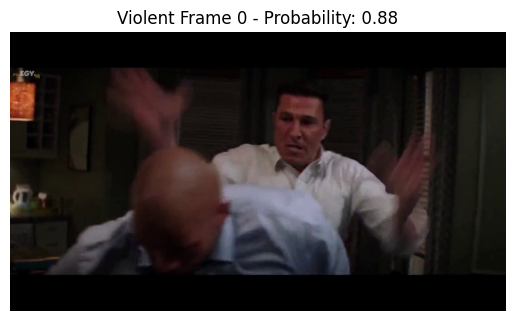

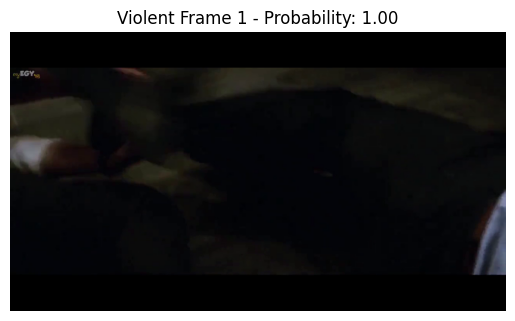

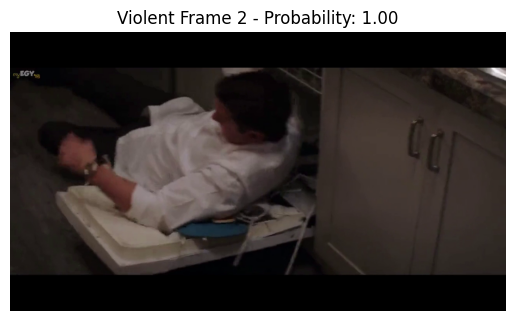

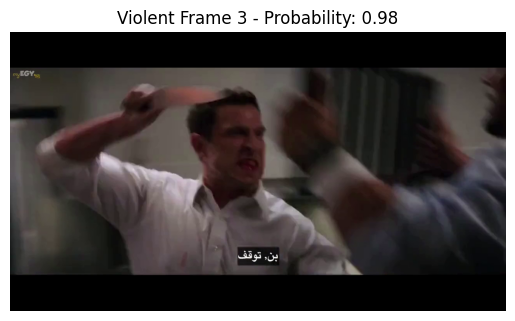

Analysis complete. Violent frames detected: 4.


In [ ]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import img_to_array
import tensorflow as tf

# Disable TensorFlow logging
tf.get_logger().setLevel('ERROR')

# Load the trained model in SavedModel format
model = load_model('/content/drive/My Drive/Real Life Violence Dataset/violence_detection_model.keras')

# Path to the video that will be tested
video_path = '/content/drive/My Drive/video_test/test10.mp4'  # Adjusted path to include the video folder

# Directory to save violent frames
output_violent_frames_dir = 'violent_frames'
if not os.path.exists(output_violent_frames_dir):
    os.makedirs(output_violent_frames_dir)

# Function to preprocess the frame for the model
def preprocess_frame(frame):
    frame = cv2.resize(frame, (224, 224))  # Resize the frame to (224, 224)
    frame = img_to_array(frame)  # Convert the frame to an array
    frame = np.expand_dims(frame, axis=0)  # Add an additional dimension
    frame = frame / 255.0  # Rescale values to [0,1]
    return frame

# Function to analyze the video and extract violent frames
def analyze_video(video_path):
    cap = cv2.VideoCapture(video_path)
    violent_frame_count = 0
    fps = int(cap.get(cv2.CAP_PROP_FPS))  # Get frames per second

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Prepare the frame for prediction
        processed_frame = preprocess_frame(frame)

        # Make predictions using the model
        prediction = model.predict(processed_frame, verbose=0)[0][0]

        if prediction > 0.7:  # If the value > 0.7, classify as violence
            violent_frame_filename = os.path.join(output_violent_frames_dir, f"violent_frame{violent_frame_count}.jpg")
            cv2.imwrite(violent_frame_filename, frame)

            # Display the violent frame
            plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
            plt.title(f"Violent Frame {violent_frame_count} - Probability: {prediction:.2f}")
            plt.axis('off')
            plt.show()

            violent_frame_count += 1

            # Skip 10 seconds of video
            skip_frames = fps * 10  # Number of frames to skip in 10 seconds
            cap.set(cv2.CAP_PROP_POS_FRAMES, cap.get(cv2.CAP_PROP_POS_FRAMES) + skip_frames)

    cap.release()

    # If no violent frames are detected, print the message
    if violent_frame_count == 0:
        print("No violent frames detected. The video is classified as non-violent.")
    else:
        print(f"Analysis complete. Violent frames detected: {violent_frame_count}.")

# Test the video
analyze_video(video_path)


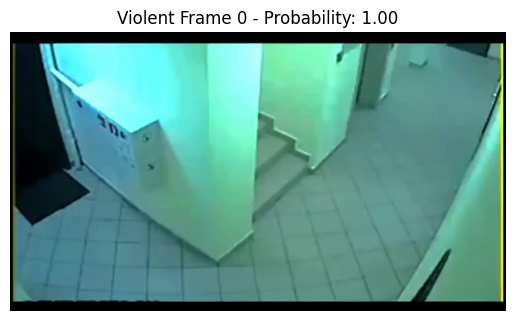

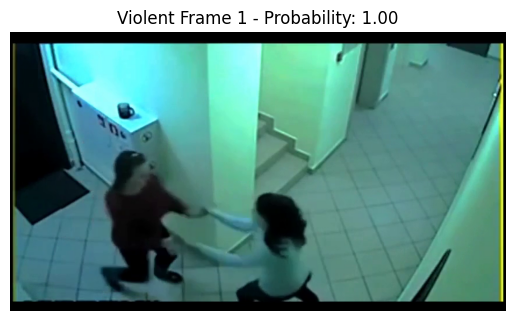

Analysis complete. Violent frames detected: 2.


In [ ]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import img_to_array
import tensorflow as tf

# Disable TensorFlow logging
tf.get_logger().setLevel('ERROR')

# Load the trained model in SavedModel format
model = load_model('/content/drive/My Drive/Real Life Violence Dataset/violence_detection_model.keras')

# Path to the video that will be tested
video_path = '/content/drive/My Drive/video_test/test11.mp4'  # Adjusted path to include the video folder

# Directory to save violent frames
output_violent_frames_dir = 'violent_frames'
if not os.path.exists(output_violent_frames_dir):
    os.makedirs(output_violent_frames_dir)

# Function to preprocess the frame for the model
def preprocess_frame(frame):
    frame = cv2.resize(frame, (224, 224))  # Resize the frame to (224, 224)
    frame = img_to_array(frame)  # Convert the frame to an array
    frame = np.expand_dims(frame, axis=0)  # Add an additional dimension
    frame = frame / 255.0  # Rescale values to [0,1]
    return frame

# Function to analyze the video and extract violent frames
def analyze_video(video_path):
    cap = cv2.VideoCapture(video_path)
    violent_frame_count = 0
    fps = int(cap.get(cv2.CAP_PROP_FPS))  # Get frames per second

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Prepare the frame for prediction
        processed_frame = preprocess_frame(frame)

        # Make predictions using the model
        prediction = model.predict(processed_frame, verbose=0)[0][0]

        if prediction > 0.7:  # If the value > 0.7, classify as violence
            violent_frame_filename = os.path.join(output_violent_frames_dir, f"violent_frame{violent_frame_count}.jpg")
            cv2.imwrite(violent_frame_filename, frame)

            # Display the violent frame
            plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
            plt.title(f"Violent Frame {violent_frame_count} - Probability: {prediction:.2f}")
            plt.axis('off')
            plt.show()

            violent_frame_count += 1

            # Skip 10 seconds of video
            skip_frames = fps * 10  # Number of frames to skip in 10 seconds
            cap.set(cv2.CAP_PROP_POS_FRAMES, cap.get(cv2.CAP_PROP_POS_FRAMES) + skip_frames)

    cap.release()

    # If no violent frames are detected, print the message
    if violent_frame_count == 0:
        print("No violent frames detected. The video is classified as non-violent.")
    else:
        print(f"Analysis complete. Violent frames detected: {violent_frame_count}.")

# Test the video
analyze_video(video_path)


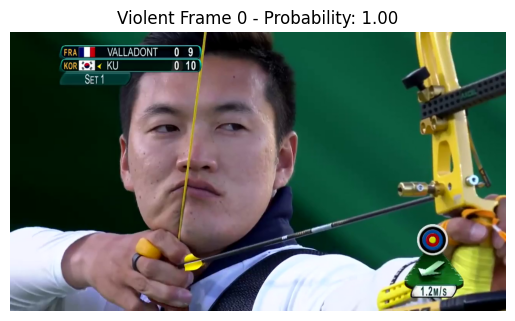

Analysis complete. Violent frames detected: 1.


In [ ]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import img_to_array
import tensorflow as tf

# Disable TensorFlow logging
tf.get_logger().setLevel('ERROR')

# Load the trained model in SavedModel format
model = load_model('/content/drive/My Drive/Real Life Violence Dataset/violence_detection_model.keras')

# Path to the video that will be tested
video_path = '/content/drive/My Drive/video_test/test.mp4'  # Adjusted path to include the video folder

# Directory to save violent frames
output_violent_frames_dir = 'violent_frames'
if not os.path.exists(output_violent_frames_dir):
    os.makedirs(output_violent_frames_dir)

# Function to preprocess the frame for the model
def preprocess_frame(frame):
    frame = cv2.resize(frame, (224, 224))  # Resize the frame to (224, 224)
    frame = img_to_array(frame)  # Convert the frame to an array
    frame = np.expand_dims(frame, axis=0)  # Add an additional dimension
    frame = frame / 255.0  # Rescale values to [0,1]
    return frame

# Function to analyze the video and extract violent frames
def analyze_video(video_path):
    cap = cv2.VideoCapture(video_path)
    violent_frame_count = 0
    fps = int(cap.get(cv2.CAP_PROP_FPS))  # Get frames per second

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Prepare the frame for prediction
        processed_frame = preprocess_frame(frame)

        # Make predictions using the model
        prediction = model.predict(processed_frame, verbose=0)[0][0]

        if prediction > 0.7:  # If the value > 0.7, classify as violence
            violent_frame_filename = os.path.join(output_violent_frames_dir, f"violent_frame{violent_frame_count}.jpg")
            cv2.imwrite(violent_frame_filename, frame)

            # Display the violent frame
            plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
            plt.title(f"Violent Frame {violent_frame_count} - Probability: {prediction:.2f}")
            plt.axis('off')
            plt.show()

            violent_frame_count += 1

            # Skip 10 seconds of video
            skip_frames = fps * 10  # Number of frames to skip in 10 seconds
            cap.set(cv2.CAP_PROP_POS_FRAMES, cap.get(cv2.CAP_PROP_POS_FRAMES) + skip_frames)

    cap.release()

    # If no violent frames are detected, print the message
    if violent_frame_count == 0:
        print("No violent frames detected. The video is classified as non-violent.")
    else:
        print(f"Analysis complete. Violent frames detected: {violent_frame_count}.")

# Test the video
analyze_video(video_path)


### Model Quantization

The code demonstrates how to quantize a trained Keras model using TensorFlow Lite, which can reduce the model size and improve inference speed without significantly impacting accuracy.

- **Model Loading**: The pre-trained violence detection model is loaded using `tf.keras.models.load_model()`. This allows access to the model's architecture and weights for further processing.

- **Quantization Process**: The code utilizes the TensorFlow Lite Converter to convert the Keras model to a TensorFlow Lite model:
  - The `TFLiteConverter.from_keras_model(model)` method initializes the converter with the loaded model.
  - The `converter.optimizations` attribute is set to `[tf.lite.Optimize.DEFAULT]`, which applies default optimizations, including quantization.
  - The model is then converted to TensorFlow Lite format using `converter.convert()`.

- **Saving the Quantized Model**: The quantized model is saved to Google Drive with the filename `violence_detection_model_quantized.tflite`. This is done using a `with open()` statement that opens the specified file in binary write mode (`'wb'`) and writes the converted model to it.

- **Success Message**: A confirmation message is printed to indicate that the quantized model has been successfully saved.

This quantization process is essential for deploying models on mobile devices or edge devices where resources are limited, helping to optimize performance while maintaining accuracy.


In [2]:
import tensorflow as tf

model = tf.keras.models.load_model('/content/drive/My Drive/Real Life Violence Dataset/violence_detection_model.keras')

converter = tf.lite.TFLiteConverter.from_keras_model(model)
converter.optimizations = [tf.lite.Optimize.DEFAULT]
tflite_model = converter.convert()

with open('/content/drive/My Drive/Real Life Violence Dataset/violence_detection_model_quantized.tflite', 'wb') as f:
    f.write(tflite_model)

print("success")


Saved artifact at '/tmp/tmpudh_7wsm'. The following endpoints are available:

* Endpoint 'serve'
  args_0 (POSITIONAL_ONLY): TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name='input_layer_1')
Output Type:
  TensorSpec(shape=(None, 1), dtype=tf.float32, name=None)
Captures:
  138079188966160: TensorSpec(shape=(), dtype=tf.resource, name=None)
  138079188969856: TensorSpec(shape=(), dtype=tf.resource, name=None)
  138079189227072: TensorSpec(shape=(), dtype=tf.resource, name=None)
  138079189229712: TensorSpec(shape=(), dtype=tf.resource, name=None)
  138079189237104: TensorSpec(shape=(), dtype=tf.resource, name=None)
  138079189236928: TensorSpec(shape=(), dtype=tf.resource, name=None)
  138079188966512: TensorSpec(shape=(), dtype=tf.resource, name=None)
  138079189224080: TensorSpec(shape=(), dtype=tf.resource, name=None)
  138079178930688: TensorSpec(shape=(), dtype=tf.resource, name=None)
  138079178931568: TensorSpec(shape=(), dtype=tf.resource, name=None)
success


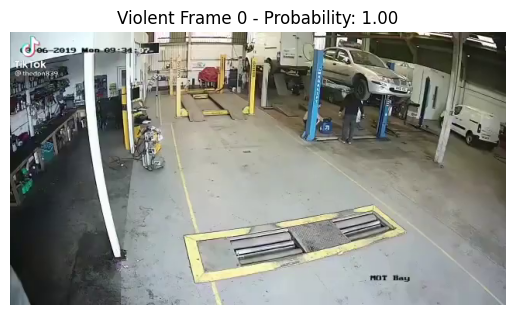

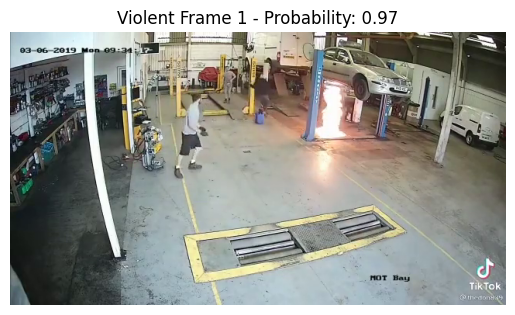

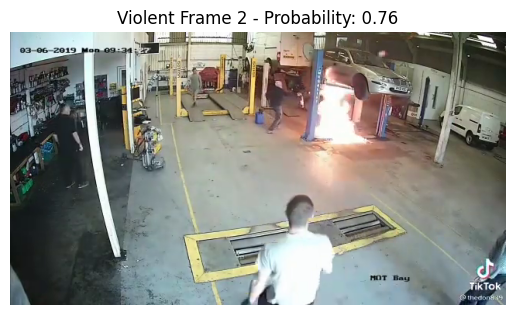

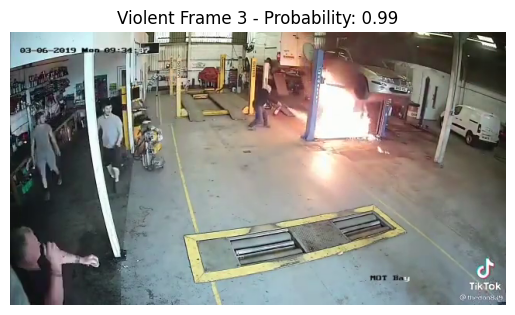

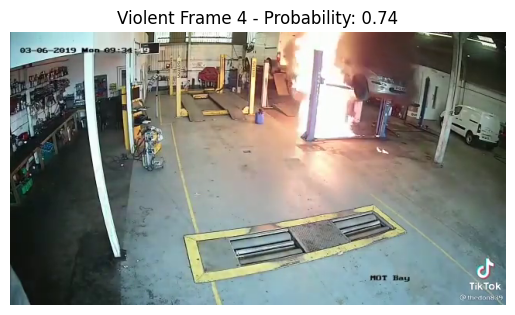

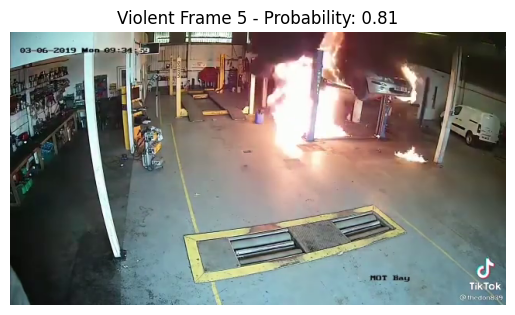

Analysis complete. Violent frames detected: 6.


In [ ]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf

# Disable TensorFlow logging
tf.get_logger().setLevel('ERROR')

# Load the trained model in TFLite format
interpreter = tf.lite.Interpreter(model_path='/content/drive/My Drive/Real Life Violence Dataset/violence_detection_model_quantized.tflite')
interpreter.allocate_tensors()

# Get input and output details
input_details = interpreter.get_input_details()
output_details = interpreter.get_output_details()

# Path to the video that will be tested
video_path = '/content/drive/My Drive/video_test/test9.mp4'  # Path to the video

# Directory to save violent frames
output_violent_frames_dir = 'violent_frames'
if not os.path.exists(output_violent_frames_dir):
    os.makedirs(output_violent_frames_dir)

# Function to preprocess the frame for the model
def preprocess_frame(frame):
    frame = cv2.resize(frame, (224, 224))  # Resize the frame to (224, 224)
    frame = frame.astype(np.float32)  # Convert the frame to float32 type
    frame = np.expand_dims(frame, axis=0)  # Add an additional dimension
    frame = frame / 255.0  # Rescale values to [0,1]
    return frame

# Function to analyze the video and extract violent frames
def analyze_video(video_path):
    cap = cv2.VideoCapture(video_path)
    violent_frame_count = 0
    fps = int(cap.get(cv2.CAP_PROP_FPS))  # Get frames per second

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Prepare the frame for prediction
        processed_frame = preprocess_frame(frame)

        # Set the input tensor for the model
        interpreter.set_tensor(input_details[0]['index'], processed_frame)

        # Make predictions using the model
        interpreter.invoke()
        prediction = interpreter.get_tensor(output_details[0]['index'])[0][0]

        if prediction > 0.7:  # If the value > 0.7, classify as violence
            violent_frame_filename = os.path.join(output_violent_frames_dir, f"violent_frame{violent_frame_count}.jpg")
            cv2.imwrite(violent_frame_filename, frame)  # Save the violent frame

            # Display the violent frame
            plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
            plt.title(f"Violent Frame {violent_frame_count} - Probability: {prediction:.2f}")
            plt.axis('off')
            plt.show()

            violent_frame_count += 1

            # Skip 10 seconds of video
            skip_frames = fps * 10  # Number of frames to skip in 10 seconds
            cap.set(cv2.CAP_PROP_POS_FRAMES, cap.get(cv2.CAP_PROP_POS_FRAMES) + skip_frames)

    cap.release()

    # If no violent frames are detected, print the message
    if violent_frame_count == 0:
        print("No violent frames detected. The video is classified as non-violent.")
    else:
        print(f"Analysis complete. Violent frames detected: {violent_frame_count}.")

analyze_video(video_path)
